In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm.autonotebook import tqdm
from joblib import Parallel, delayed
import umap
import pandas as pd

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [3]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir
from avgn.visualization.spectrogram import draw_spec_set
from avgn.utils.buckeye_utils import VOWEL_CONSONANT
from avgn.signalprocessing.create_spectrogram_dataset import flatten_spectrograms


In [4]:
from avgn.visualization.projections import scatter_spec
from avgn.utils.general import save_fig
from avgn.utils.paths import FIGURE_DIR, ensure_dir

### load data

In [5]:
DATASET_ID = 'buckeye'

In [6]:
embedding_dict = {}

for cat in ['consonants', 'vowels']:
    embedding_dict[cat] = {}
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        save_loc = DATA_DIR / 'syllable_dfs' / DATASET_ID /  'embeddings' / (cat + '_' + phone_group + '.pickle')
        embedding_dict[cat][phone_group] = pd.read_pickle(save_loc)

In [7]:
mean_specs_df =  pd.read_pickle(DATA_DIR / 'syllable_dfs' / DATASET_ID / 'phones_mean.pickle')

In [8]:
mean_specs_df[:3]

,ah,ih,n,s,eh,t,iy,r,k,l,...,en,uh,sh,aw,ch,jh,el,em,zh,own
0,"[[0.4247671890689864, 0.44366481019570325, 0.4...","[[0.4487310393507725, 0.4658653849146514, 0.48...","[[0.6089430345171808, 0.6293126609842211, 0.64...","[[0.39133156074041925, 0.40924441466665556, 0....","[[0.4058770532318084, 0.42614768451371915, 0.4...","[[0.4140381810812835, 0.42679419097007304, 0.4...","[[0.4907670509480515, 0.5148469261591413, 0.53...","[[0.4207396366496286, 0.4352143141695627, 0.44...","[[0.4446645572126484, 0.46262515433932244, 0.4...","[[0.4338201177109475, 0.4476989166761143, 0.46...",...,"[[0.4873954965738874, 0.511441416816685, 0.531...","[[0.45182674126453287, 0.4695456782448742, 0.4...","[[0.36843022589152397, 0.3875846478942423, 0.3...","[[0.40703641002408186, 0.4382468187923721, 0.4...","[[0.32152404540763563, 0.3391331269349847, 0.3...","[[0.4018901527461815, 0.42033582493771177, 0.4...","[[0.4190174791267525, 0.4447200737955008, 0.46...","[[0.44870031928855364, 0.47966282083929007, 0....","[[0.5100726288529316, 0.5321845123352217, 0.54...","[[0.5005949764061072, 0.5259708666725291, 0.53..."


### make plots of different phoneme categories

In [9]:
embedding_dict[cat][phone_group][:3]

,start_time,end_time,labels,word,utterance_number,position_in_utterance,position_in_word,word_number,indv,indvi,age,sex,key,rate,spectrogram,embedding
8,25.307442,25.461083,er,over,8,3,2,3,s25,0,o,f,s2501b,16000,"[[136, 160, 160, 163, 165, 168, 165, 164, 164,...","[2.7119128704071045, -2.6757278442382812]"
81,32.357823,32.547882,er,over,9,3,2,3,s25,0,o,f,s2501b,16000,"[[227, 235, 238, 237, 235, 231, 230, 227, 225,...","[2.0563886165618896, -2.3490538597106934]"
99,34.308480,34.414322,er,over,27,10,2,10,s25,0,o,f,s2501b,16000,"[[209, 212, 217, 221, 226, 232, 237, 240, 241,...","[2.4156322479248047, -2.620695114135742]"


In [10]:
import seaborn as sns

In [11]:
for cat in ['consonants', 'vowels']:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        z = np.vstack(embedding_dict[cat][phone_group].embedding.values)
        alpha = np.min([np.max([1 - (len(z) / 200000), 0.001]), 1])
        print(np.log(len(z)), len(z), alpha)
        

11.821446392354721 136141 0.319295
9.135077887475635 9275 0.953625
11.353132229156781 85232 0.57384
11.795710566809303 132682 0.33658999999999994
11.280577179776333 79267 0.603665
10.470929776721015 35275 0.823625
11.308186505332124 81486 0.59257
12.549921181668651 282073 0.001
11.00401467340901 60115 0.699425
9.39357817555449 12011 0.939945



11.024431946410647 61355 0.693225
11.127395328341542 68009 0.6599550000000001
12.176654133447505 194202 0.02898999999999996
11.643567687960724 113956 0.43022000000000005
11.65344364306619 115087 0.42456499999999997
10.409340834675561 33168 0.83416
11.7958914340683 132706 0.33647000000000005
11.161877516896627 70395 0.6480250000000001
11.69677918074226 120184 0.39908
10.342645301610762 31028 0.8448599999999999



In [12]:
import matplotlib.patheffects as PathEffects


In [13]:
ensure_dir(FIGURE_DIR / 'phones')

In [20]:
cpal = 'hls'

In [24]:
from matplotlib import gridspec

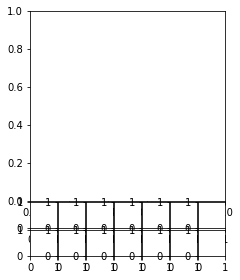

In [74]:
zoom = 0.5
nrows = 2
column_size = 7
figsize = (zoom*column_size, zoom*(column_size+nrows))
fig = plt.figure(figsize=(figsize))
gs = gridspec.GridSpec(column_size+nrows, column_size, wspace=0.025, hspace=0.05)
main_ax = fig.add_subplot(gs[: column_size, :column_size])
label_axs = {}
for i in range(column_size*nrows):
    
    if i ==0:
        col = 0
        row=0
    else:
        row = int(np.floor(i/column_size))
        col = i - row*column_size
    #print(i, row, col)
    label_axs[i] = fig.add_subplot(gs[column_size + row, col])

In [80]:
ensure_dir(FIGURE_DIR / "phones_margin")

Plosives
11.821446392354721 136141 0.319295


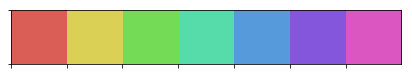

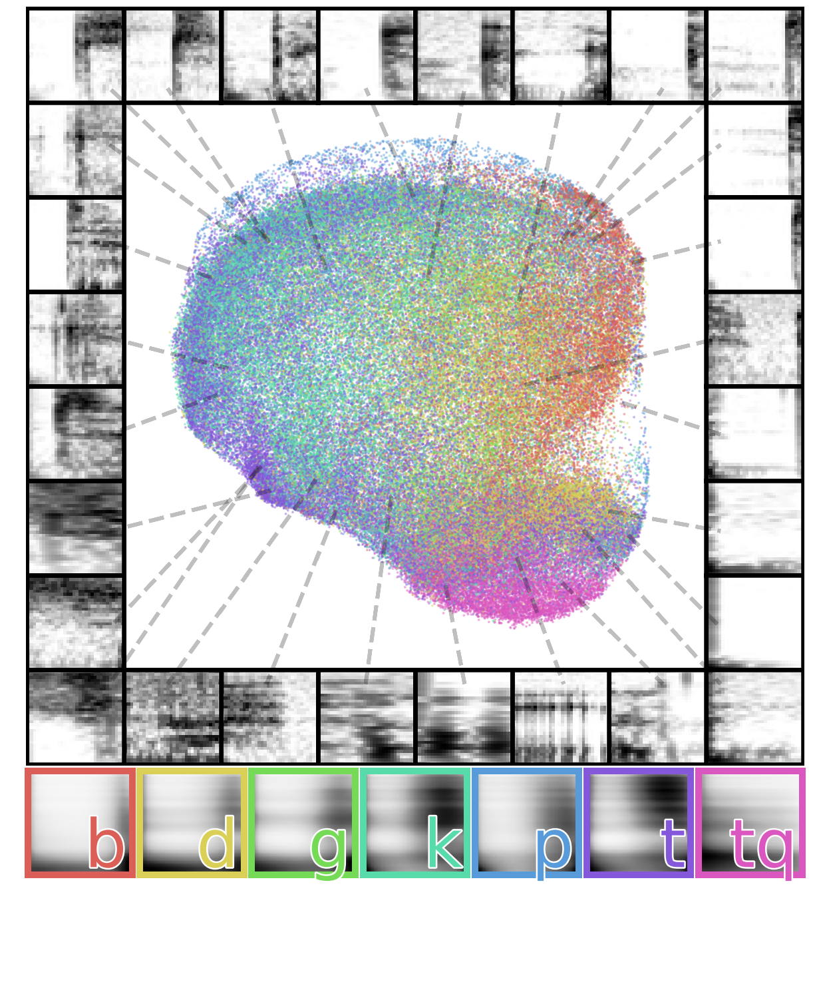

Affricates
9.135077887475635 9275 0.953625


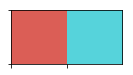

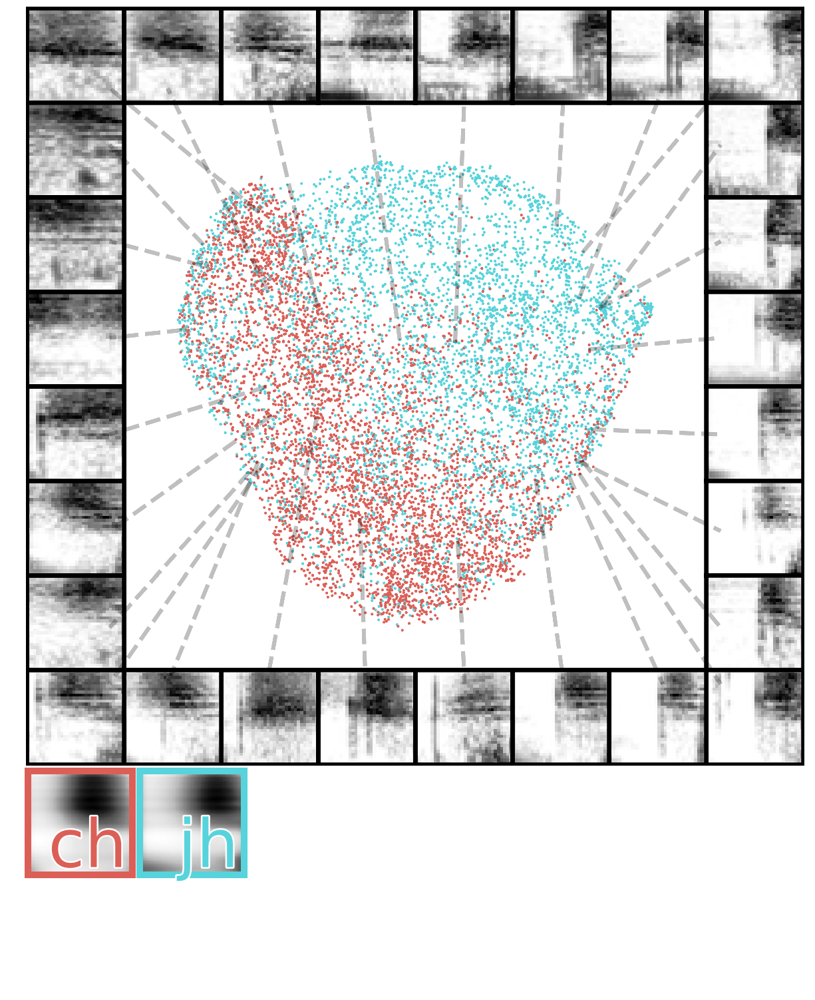

Nasals
11.353132229156781 85232 0.57384


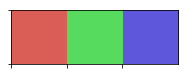

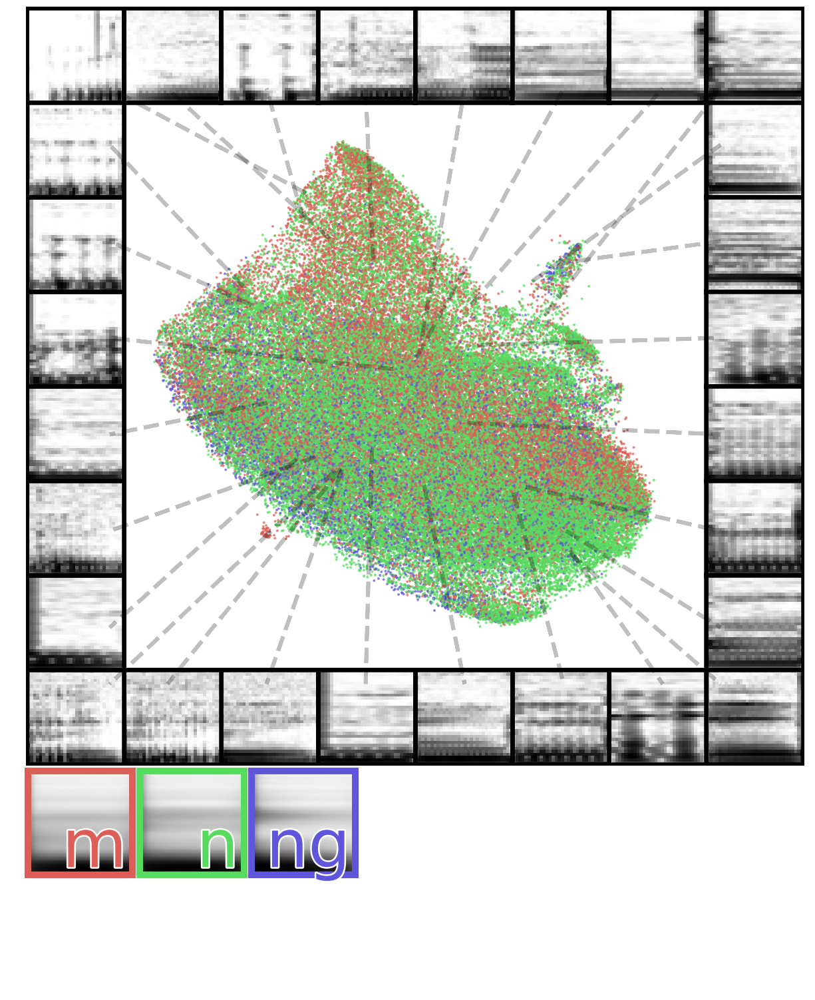

Fricatives
11.795710566809303 132682 0.33658999999999994


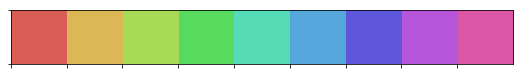

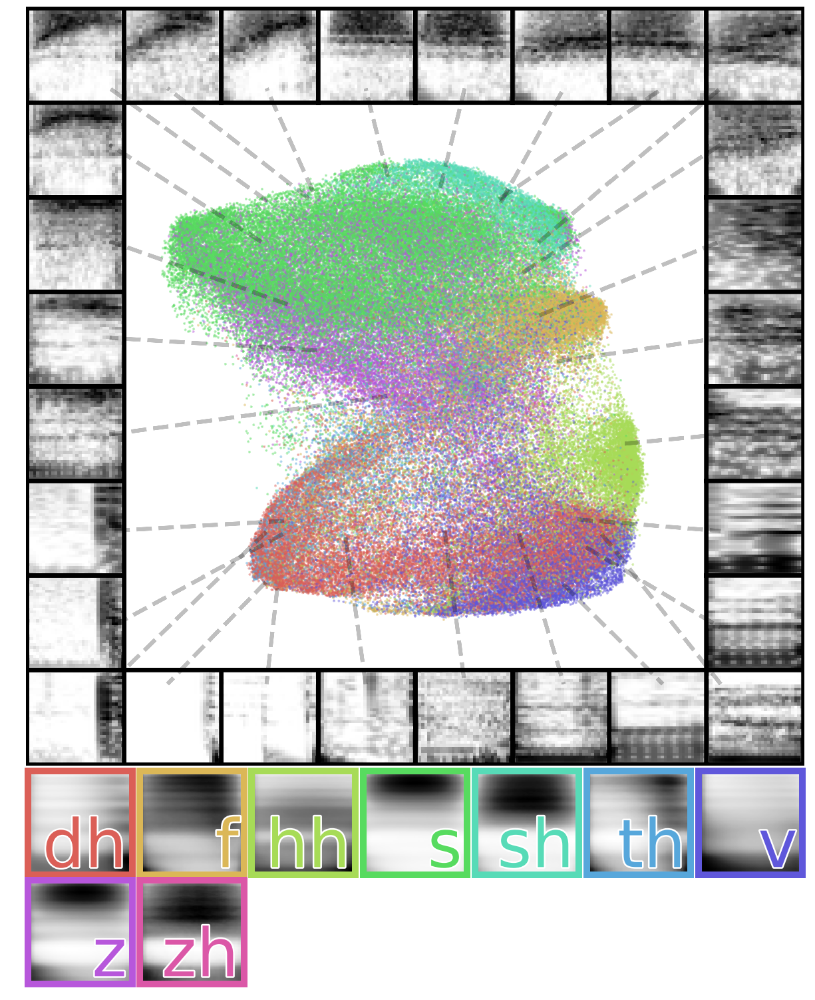

Liquids
11.28052671614168 79263 0.603685


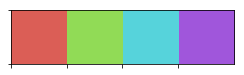

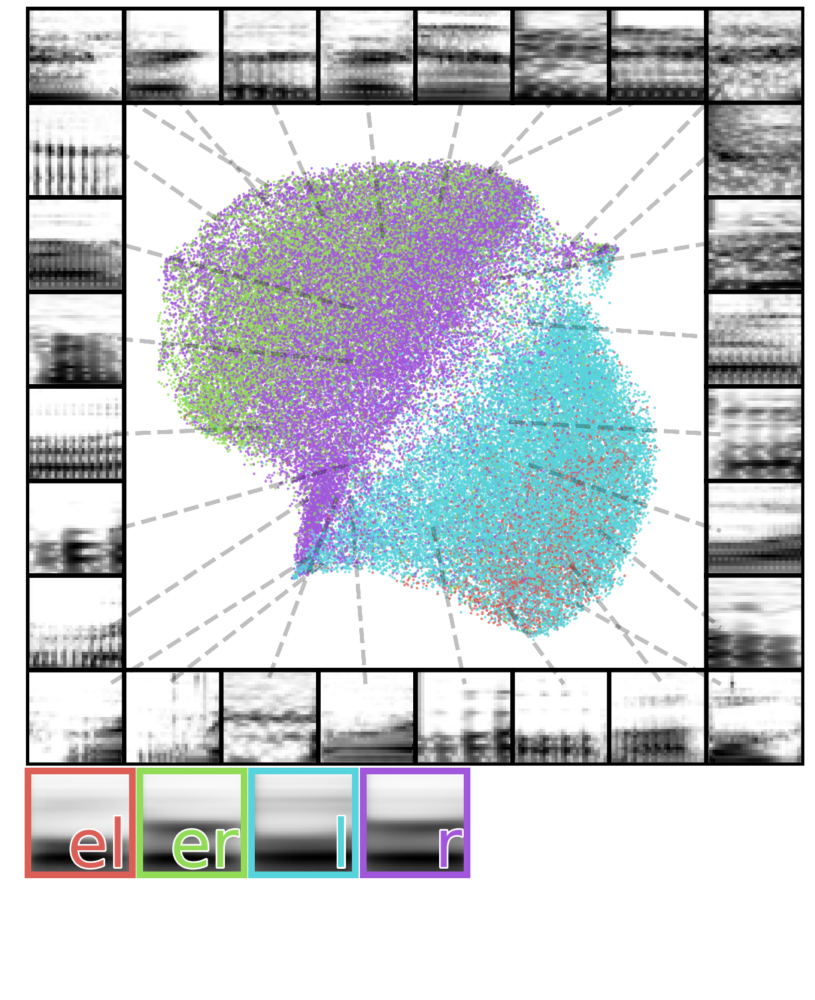

Glides
10.470929776721015 35275 0.823625


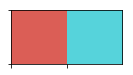

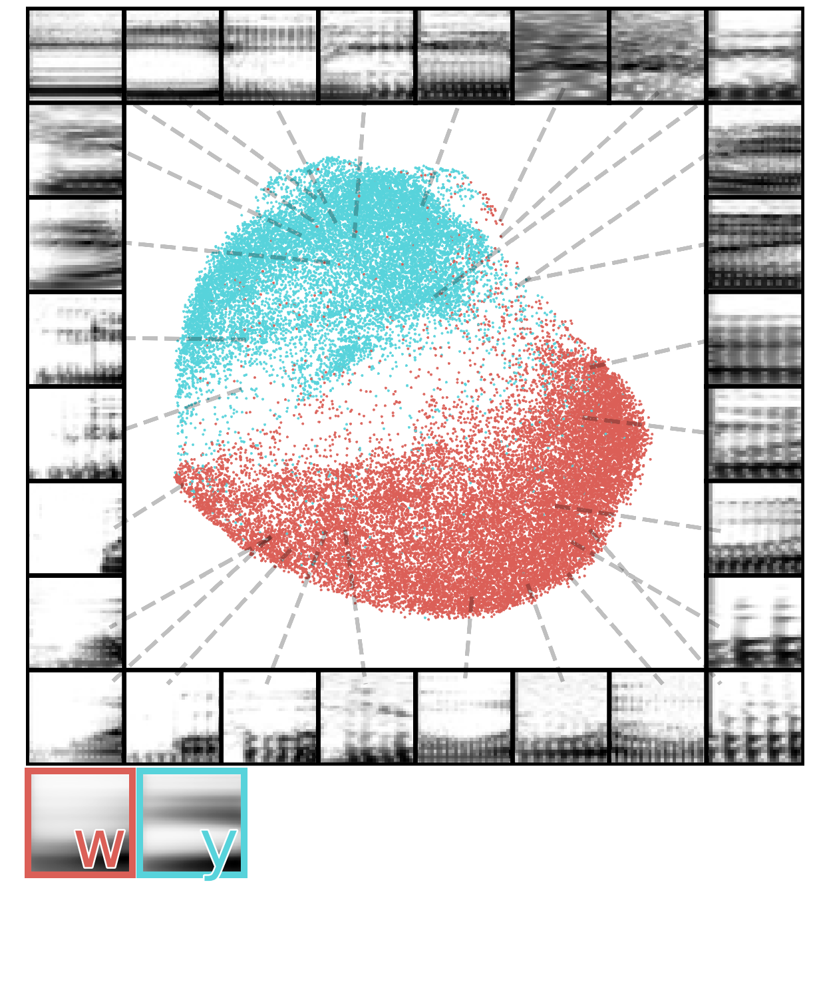

Labials
11.308186505332124 81486 0.59257


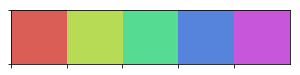

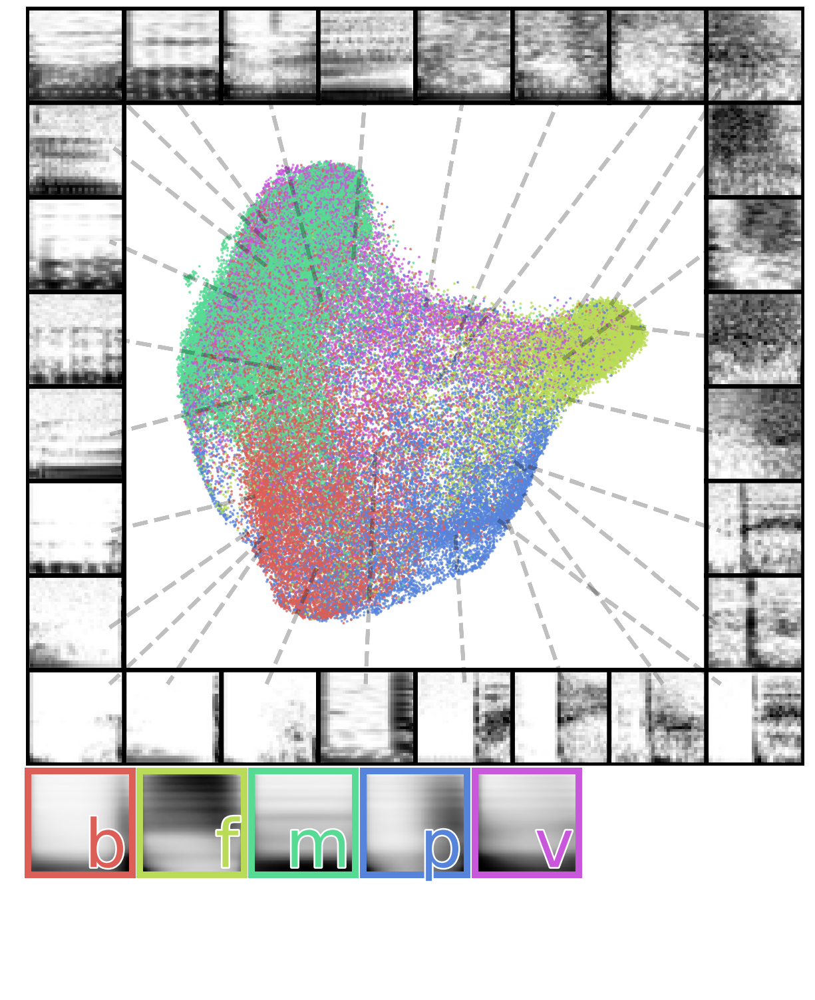

Coronals
12.549907000841838 282069 0.1


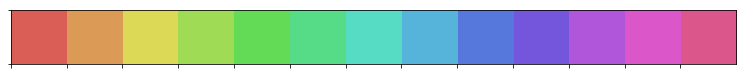

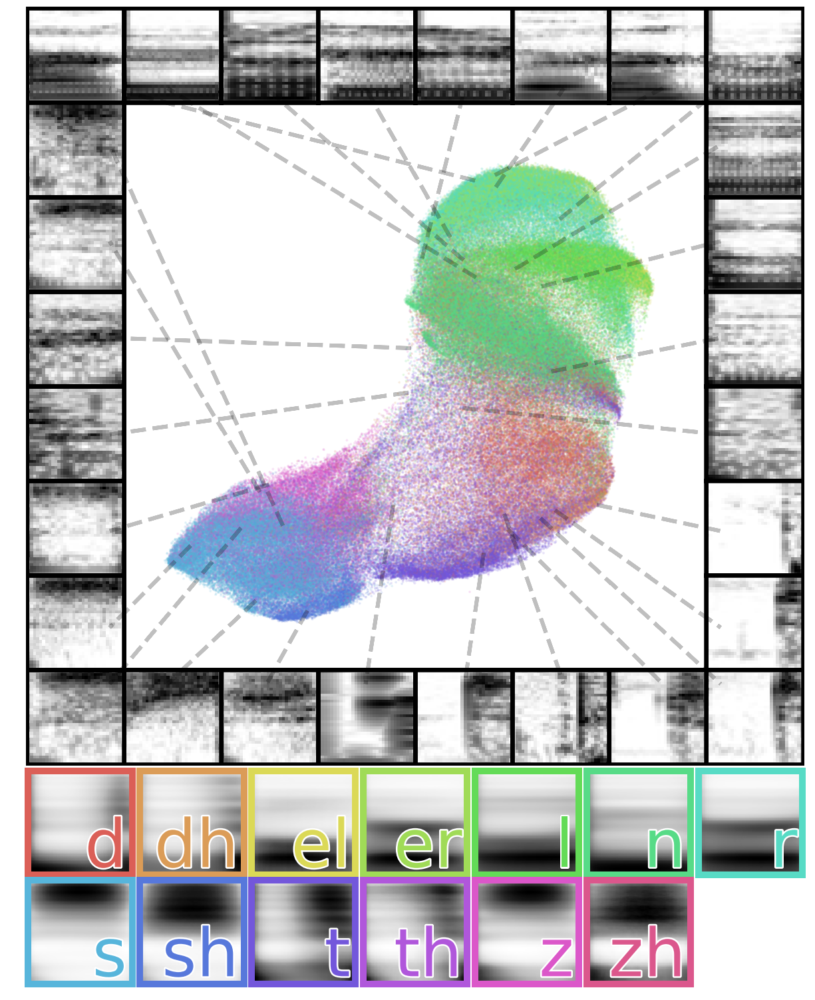

Dorsals
11.00401467340901 60115 0.699425


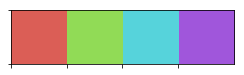

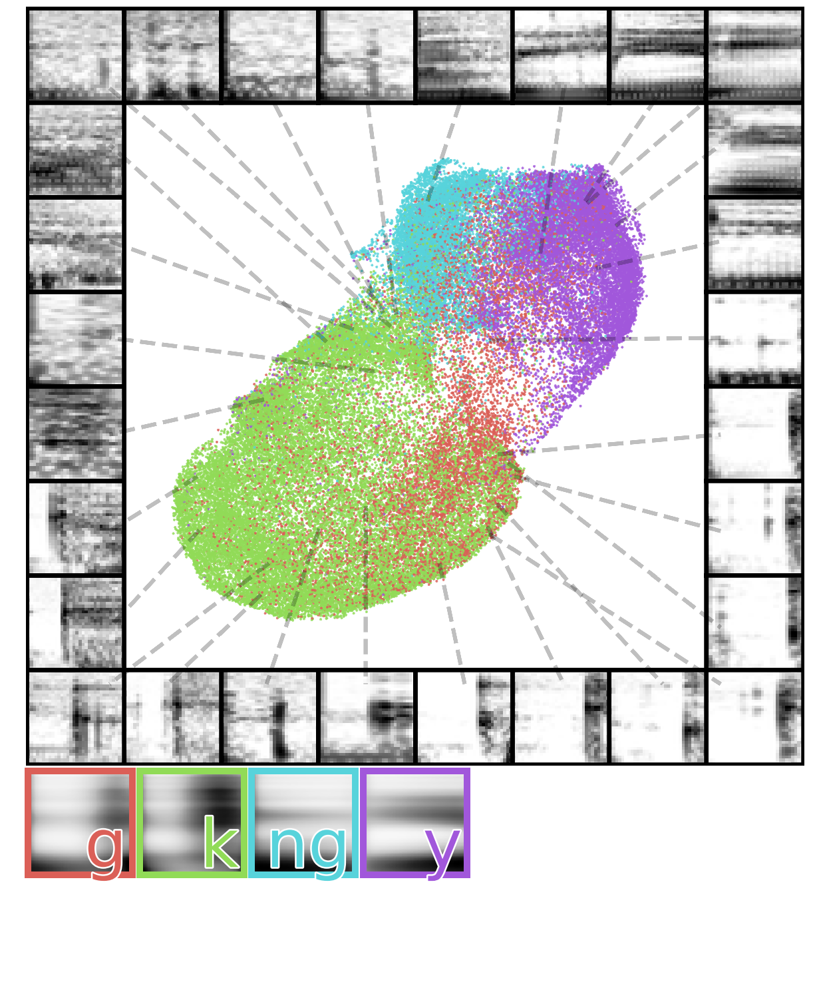

Laryngeals


Diphthong
11.015854806436574 60831 0.695845


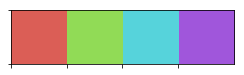

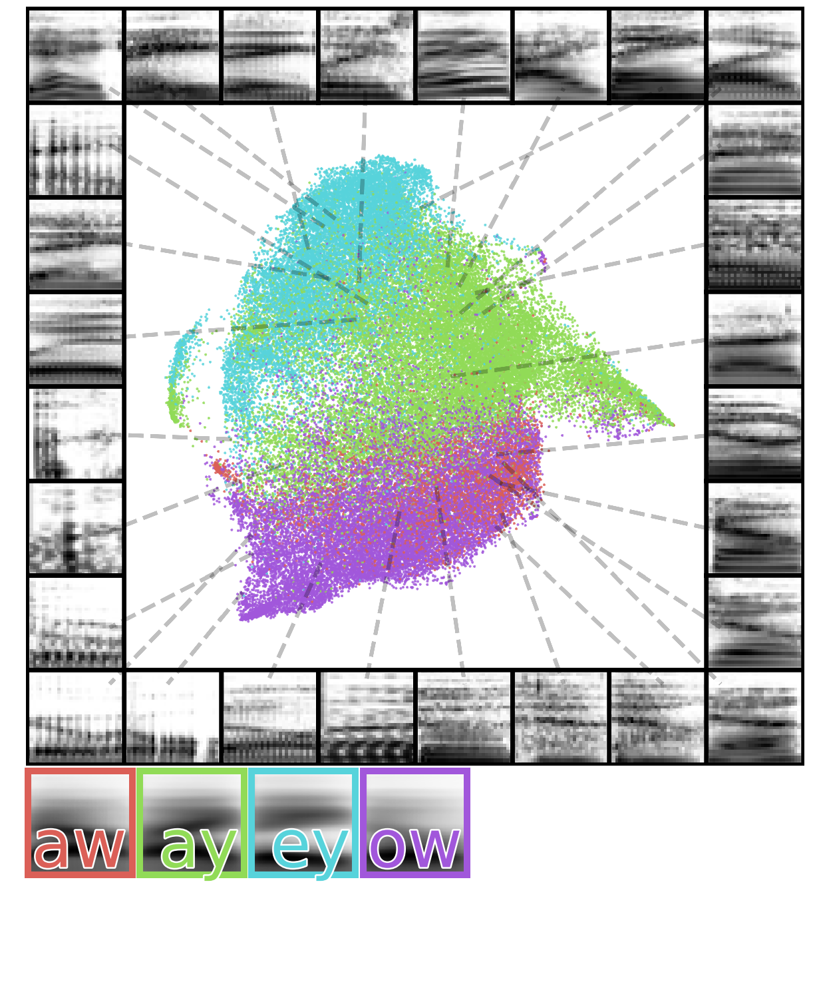

Long vowels
11.127395328341542 68009 0.6599550000000001


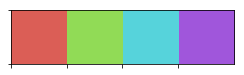

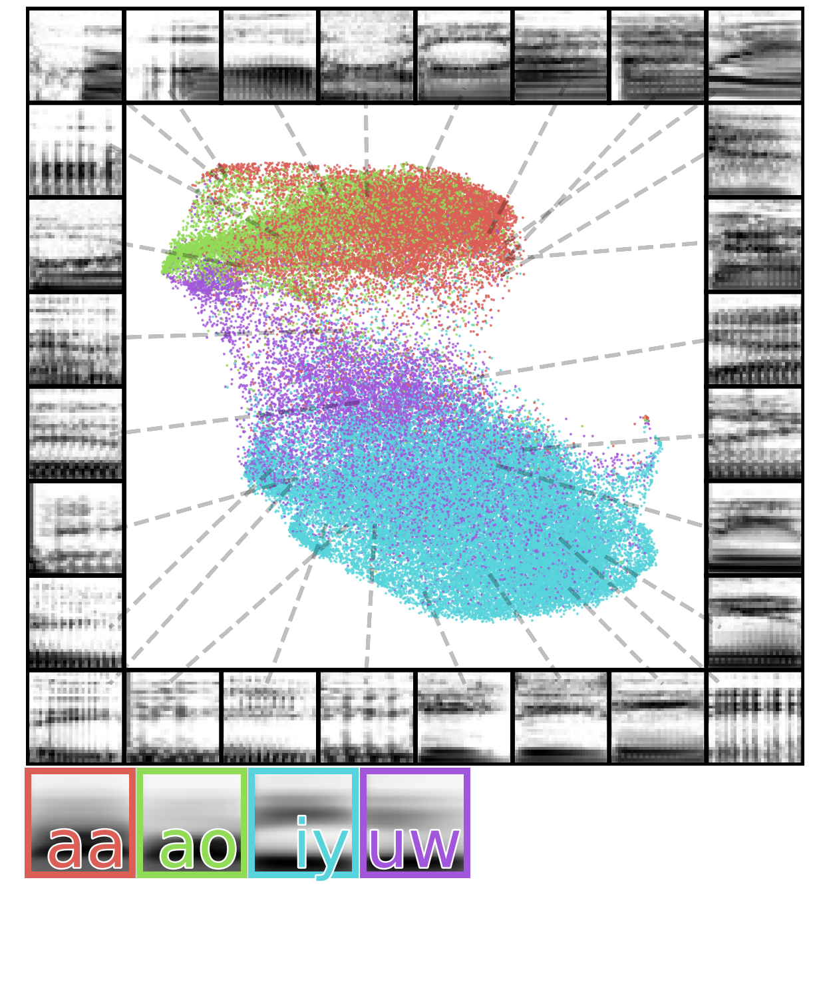

Short vowels
12.176654133447505 194202 0.1


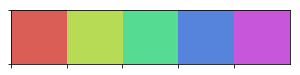

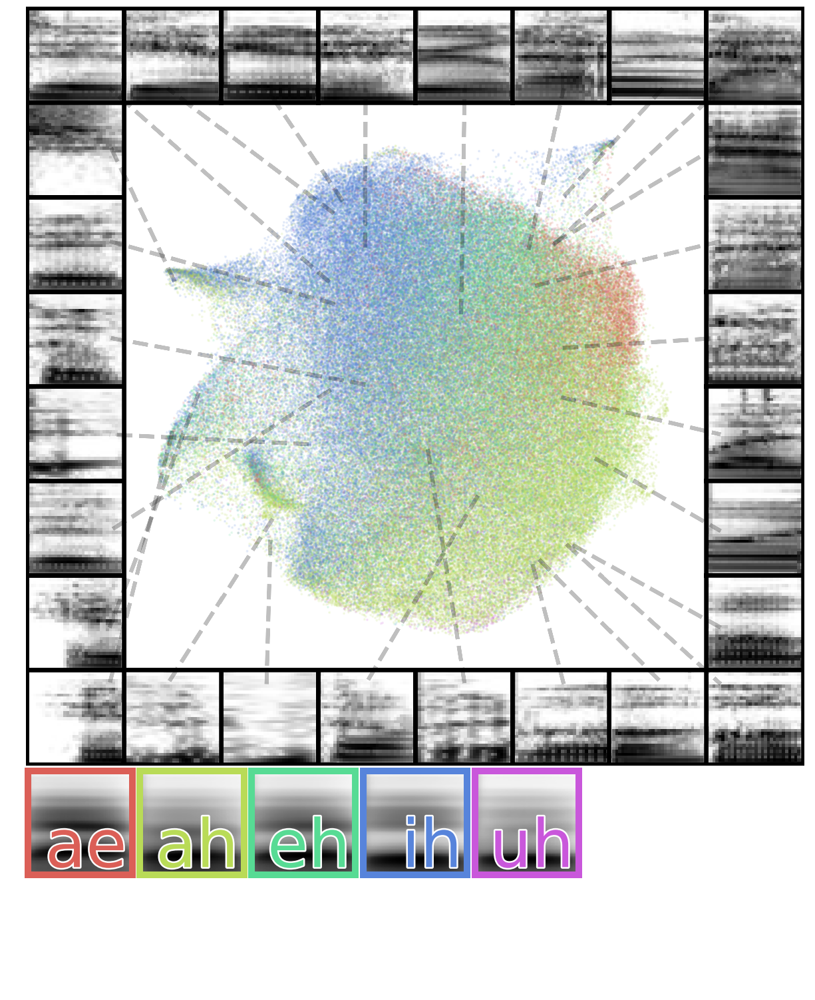

High vowels
11.643567687960724 113956 0.43022000000000005


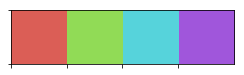

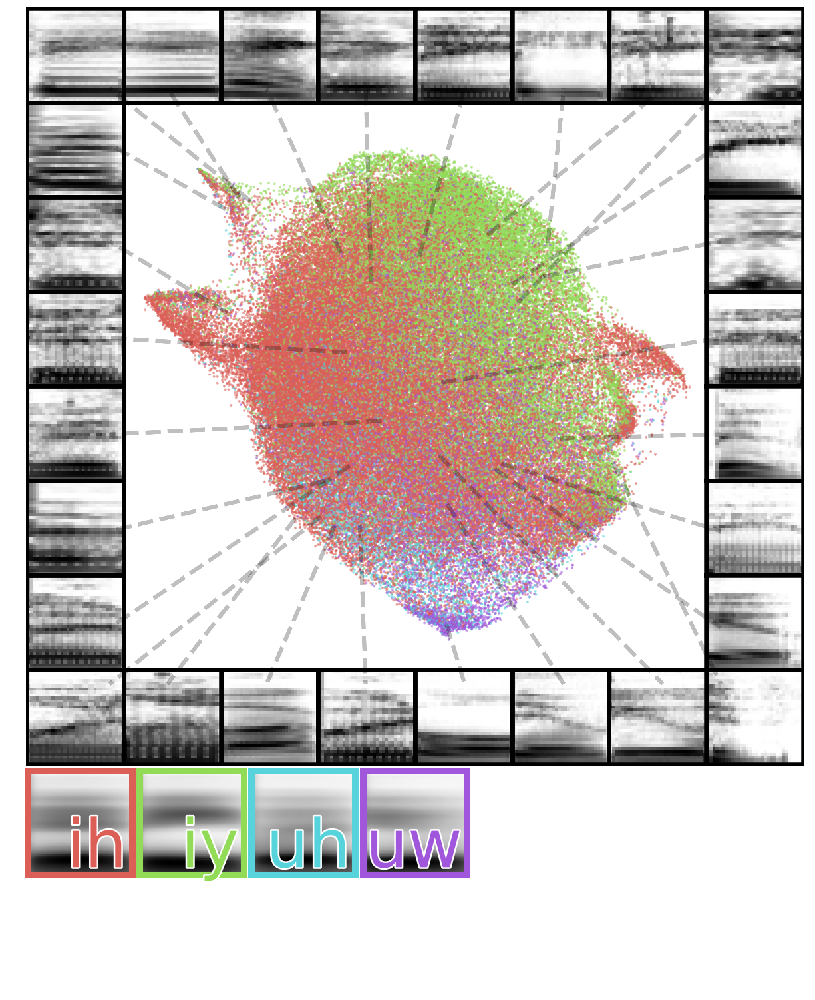

Mid vowels
11.65344364306619 115087 0.42456499999999997


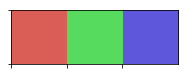

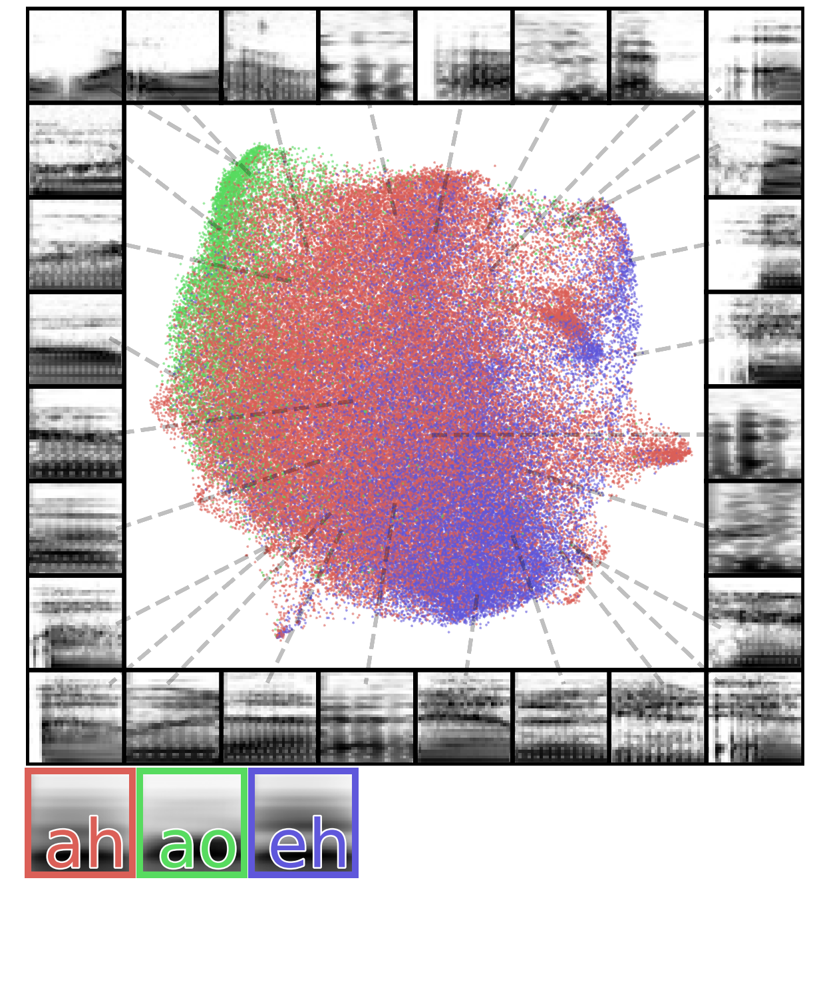

Low vowels
10.409340834675561 33168 0.83416


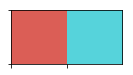

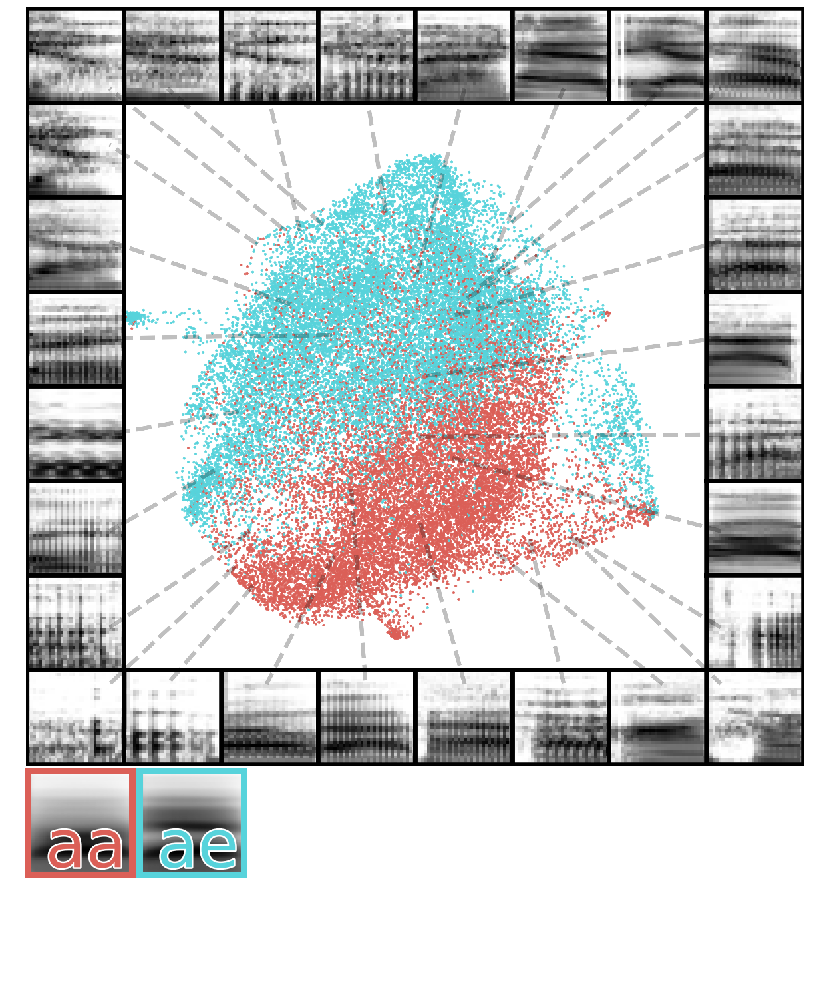

Front vowels
11.7958914340683 132706 0.33647000000000005


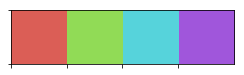

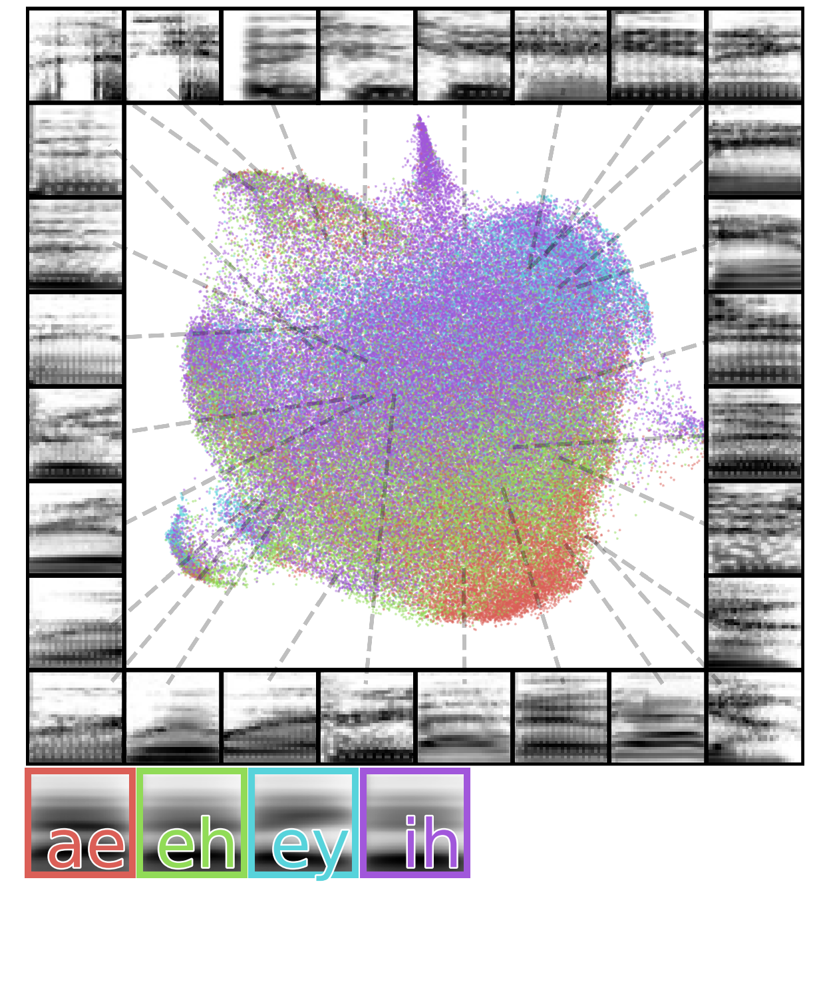

Central vowels
Back vowels
11.69677918074226 120184 0.39908


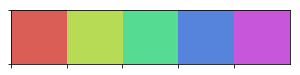

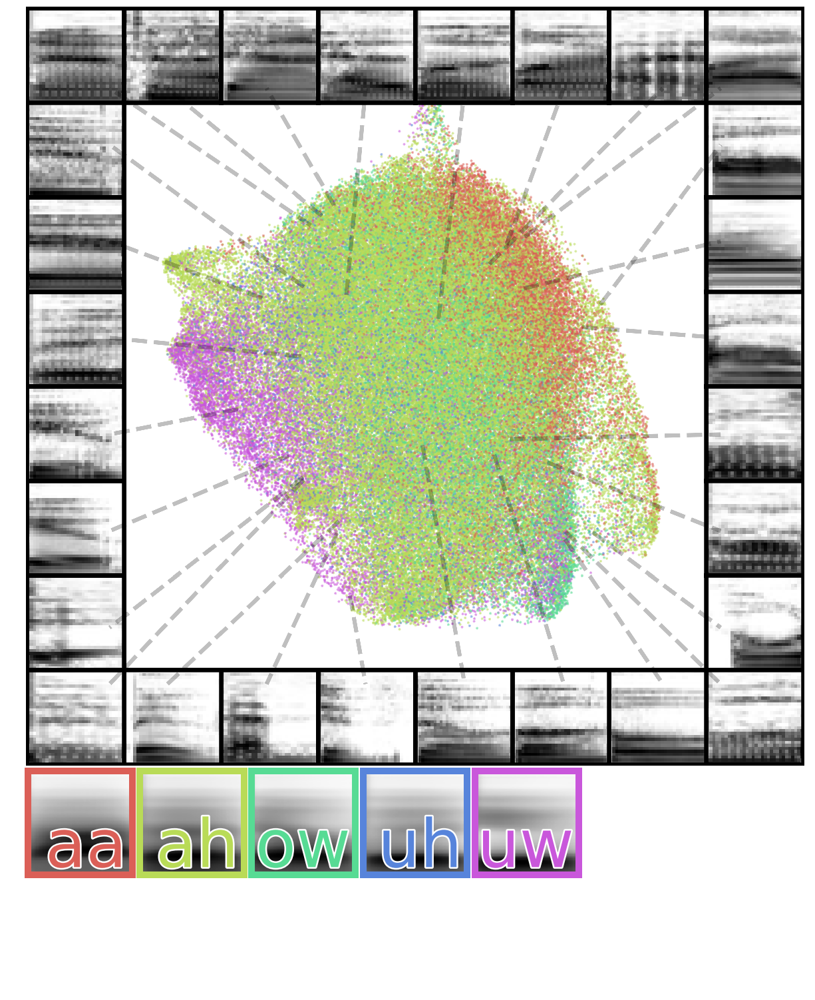

Syllabic consonants
10.342645301610762 31028 0.8448599999999999


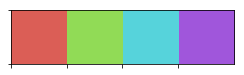

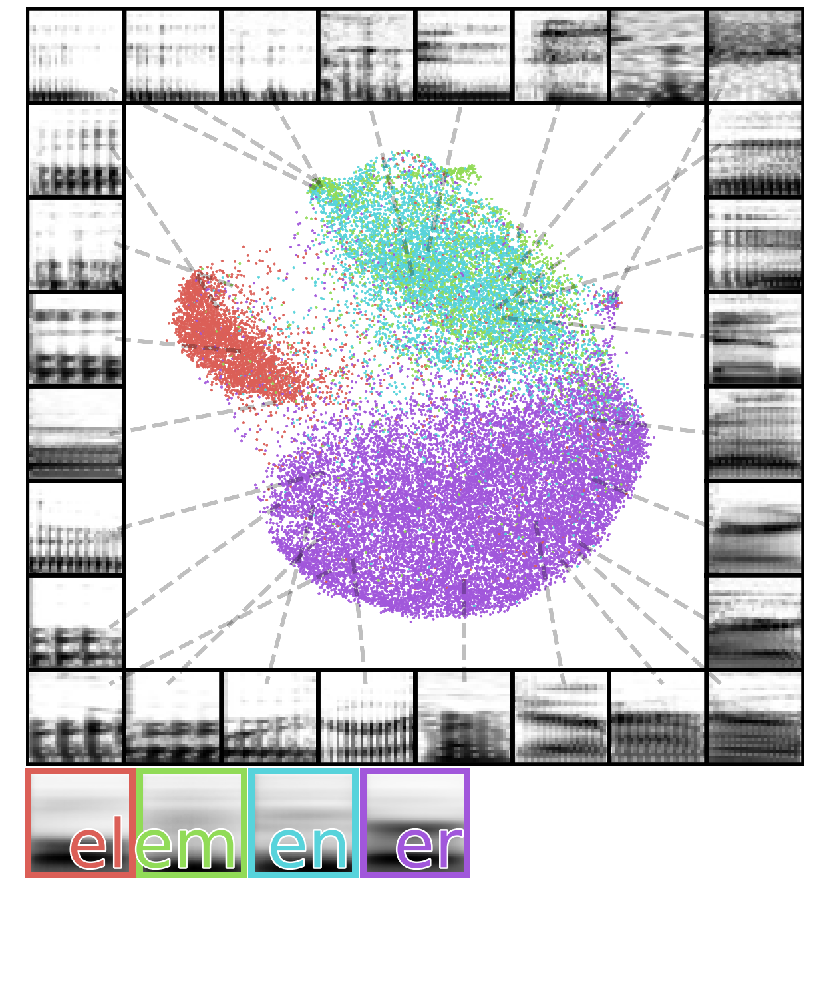

In [91]:
zoom = 3
nrows = 2
column_size = 7
figsize = (zoom * column_size, zoom * (column_size + nrows))

for cat in ["consonants", "vowels"]:
    for phone_group in tqdm(VOWEL_CONSONANT[cat].keys()):
        print(phone_group)
        embed_df = embedding_dict[cat][phone_group]
        lab_mask = [
            lab for lab in embed_df.labels.unique() if lab in mean_specs_df.columns
        ]
        if len(lab_mask) < 2:
            continue
        embed_df = embed_df[embed_df.labels.isin(lab_mask)]

        z = np.vstack(embed_df.embedding.values)
        labels = embed_df.labels.values
        specs = np.array(list(embed_df.spectrogram.values))

        pal = sns.color_palette(cpal, len(np.unique(labels)))
        sns.palplot(pal)

        fig = plt.figure(figsize=(figsize))
        gs = gridspec.GridSpec(
            column_size + nrows, column_size, wspace=0.025, hspace=0.05
        )
        main_ax = fig.add_subplot(gs[:column_size, :column_size])
        label_axs = {}
        for i in range(column_size * nrows):

            if i == 0:
                col = 0
                row = 0
            else:
                row = int(np.floor(i / column_size))
                col = i - row * column_size
            label_axs[i] = fig.add_subplot(gs[column_size + row, col])

        for pi, (lab, pa) in enumerate(zip(np.unique(labels), pal)):
            phone_spec = mean_specs_df[lab].values[0]
            ax = label_axs[pi]
            ax.matshow(phone_spec, cmap=plt.cm.Greys, origin="lower")
            # ax.axis('off')
            for spine in ax.spines.values():
                spine.set_edgecolor(pa)
                spine.set_linewidth(10)
            ax.get_xaxis().set_ticks([])
            ax.get_yaxis().set_ticks([])
            txt = ax.text(
                0.95,
                0.25,
                lab,
                fontsize=100,
                transform=ax.transAxes,
                color=np.array(pa),#*.5,
                horizontalalignment="right",
                verticalalignment="center",
            )
            txt.set_path_effects([PathEffects.withStroke(linewidth=5, foreground="w")])

        for axi in range(pi + 1, nrows * column_size):
            ax = label_axs[axi]
            ax.axis("off")

        # save_fig(FIGURE_DIR / 'phones' / (cat + '_' +phone_group + '_labels'), dpi=300, save_jpg=True, save_png=True)

        alpha = np.min([np.max([1 - (len(z) / 200000), 0.1]), 1])
        print(np.log(len(z)), len(z), alpha)

        scatter_spec(
            np.vstack(z),
            specs,
            column_size=8,
            pal_color="hls",
            color_points=False,
            enlarge_points=0,
            figsize=(10, 10),
            range_pad=0.15,
            scatter_kwargs={
                "labels": list(labels),
                "alpha": alpha,
                "s": 1,
                "show_legend": False,
                "color_palette": cpal,
            },
            matshow_kwargs={"cmap": plt.cm.Greys},
            line_kwargs={"lw": 3, "ls": "dashed", "alpha": 0.25},
            draw_lines=True,
            n_subset=1000,
            border_line_width=3,
            ax=main_ax,
        )

        main_ax.axis("off")

        save_fig(
            FIGURE_DIR / "phones_margin" / (cat + "_" + phone_group + "_projections"),
            dpi=300,
            save_jpg=True,
            save_png=True,
        )
        plt.show()
        #break
    #break